In [1]:
using thesis, PRMaps
using StatsPlots
using Pandas
using Healpix
using StatsPlots
using Plots
using LinearAlgebra

import Stripeline as Sl

In [2]:
wmap = read_pickle("../instruments/wmap_instrument.pkl")
planck = read_pickle("../instruments/planck_instrument.pkl")
quijote = read_pickle("../instruments/quijote_instrument.pkl")
swipe = read_pickle("../instruments/lspe_swipe_instrument.pkl")
strip = read_pickle("../instruments/lspe_strip_instrument.pkl")

columns = ["instrument", "frequency", "depth_p", "depth_i"]

instruments = concat([wmap, planck, quijote, swipe, strip])
instruments = instruments[columns]
instruments

,instrument,frequency,depth_p,depth_i
0,WMAP,22.69,294.697795,293.465609
1,WMAP,32.94,438.561419,296.828735
2,WMAP,40.72,500.985656,415.023172
3,WMAP,40.51,475.110192,393.646897
4,WMAP,60.09,554.721784,520.189018
5,WMAP,60.96,493.519146,462.909657
6,WMAP,92.87,783.584095,750.749159
7,WMAP,93.43,876.013202,839.182282
8,WMAP,92.44,926.757510,887.748258
9,WMAP,93.22,899.656576,861.132559


In [3]:
nside = 64
sky_model = "c1s0d0"

cam_ang = Sl.CameraAngles()
 
setup = PRMaps.Setup(
    sampling_freq_Hz = 100,
    total_time_s = 24. * 3600. * 1.
    )
nothing

# Run simulation without the error

In [4]:
result = run_simulation(instruments, cam_ang, setup, sky_model, nside)

┌ Info: Generating sky signal and noise
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:197
┌ Info: Simulating telescope scanning strategy [LSPE/Strip]
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:201


┌ Info: Adding white noise based on the instruments sensitivity
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:206
┌ Info: Run component separation using fgbuster
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:213


Dict{Any, Any} with 18 entries:
  "nit"       => 10
  "x"         => [1.55024, 19.605, -2.99884]
  "hess_inv"  => [0.000101005 -0.00396785 -6.53899e-6; -0.00396785 0.157951 0.0…
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 13
  "status"    => 0
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; … ; -1.6375e30 …
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 13
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => true
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -8.53917e7
  "Sigma"     => [0.000100659 -0.00395446 -6.4917e-6; -0.00395446 0.157432 0.00…
  "message"   => "Optimization terminated successfully."
  "Sigma_inv" => [7.75574e5 19311.1 1.08314e5; 19311.1 488.414 1912.66; 1.08314…
  "jac"       => [-2.34255e-10, -1.51311e-10, 4.8413e-9]
  "invAtNA"   => [0.0724709 -0.715696 -0.059

In [5]:
par_name = result["params"]
par_val = result["x"]
par_error = sqrt.(diag(result["Sigma"]))

for i in 1:3
    name = par_name[i]
    val = round(par_val[i]; digits = 4)
    err = round(par_error[i]; digits = 4)
    println("$name : $val ⨦ $err")
end

Dust.beta_d : 1.5502 ⨦ 0.01
Dust.temp : 19.605 ⨦ 0.3968
Synchrotron.beta_pl : -2.9988 ⨦ 0.0015


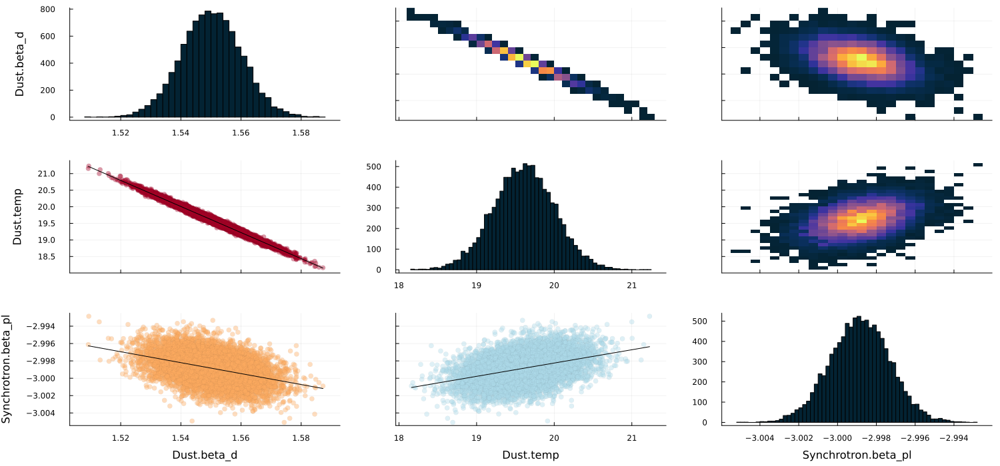

In [21]:
Plots.plot(get_corrplot(result))
#savefig("../results/corrplot_ideal.pdf")

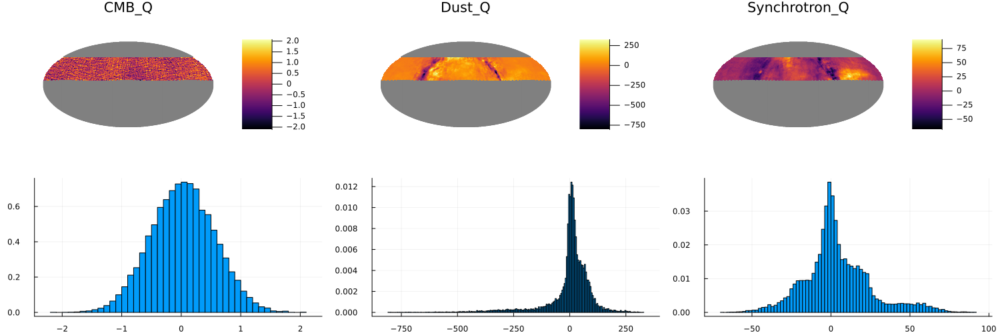

In [7]:
Plots.plot(get_map_and_hist(result, "Q", nside))

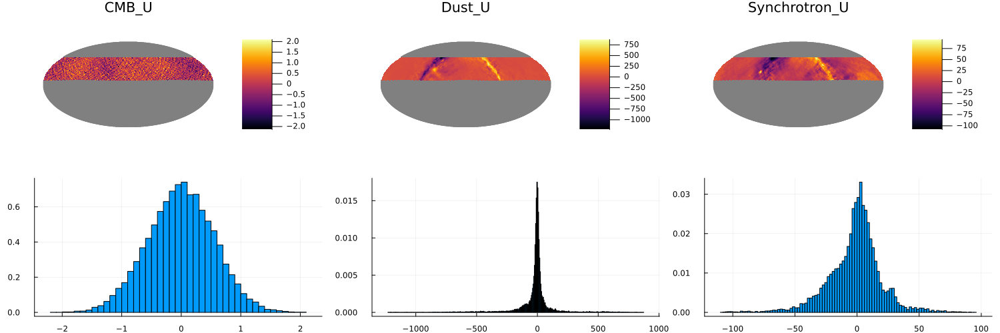

In [8]:
Plots.plot(get_map_and_hist(result, "U", nside))

# Run simulation with pointing error

In [10]:
tel_ang = Sl.TelescopeAngles(
    wheel2ang_0_rad = deg2rad(1.0),
    forkang_rad = deg2rad(1.0)
)
nothing

In [11]:
result_with_error = run_simulation_with_error(instruments, cam_ang, tel_ang, setup, sky_model, nside)

┌ Info: Generating sky signal
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:234
┌ Info: Simulating telescope scanning strategy [LSPE/Strip WITH pointing error]
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:238


┌ Info: Adding white noise based on the instruments sensitivity
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:246
┌ Info: Run component separation using fgbuster
└ @ thesis /mnt/sda1/tesi/Master-Thesis-Pipeline/src/thesis.jl:255


Dict{Any, Any} with 18 entries:
  "nit"       => 7
  "x"         => [1.53325, 20.28, -3.00257]
  "hess_inv"  => [0.000102438 -0.00432984 -6.54964e-6; -0.00432984 0.185441 0.0…
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 10
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; … ; -1.6375e30 …
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 10
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -8.53878e7
  "Sigma"     => [0.000102103 -0.00431398 -6.56781e-6; -0.00431398 0.184684 0.0…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [7.72091e5 17877.4 1.08135e5; 17877.4 420.415 1778.79; 1.08135…
  "jac"       => [0.000850529, 1.98189e-5, 8.32632e-5]
  "invAtNA"   => [0.072

In [12]:
par_name = result_with_error["params"]
par_val = result_with_error["x"]
par_error = sqrt.(diag(result_with_error["Sigma"]))

for i in 1:3
    name = par_name[i]
    val = round(par_val[i]; digits = 4)
    err = round(par_error[i]; digits = 4)
    println("$name : $val ⨦ $err")
end

Dust.beta_d : 1.5332 ⨦ 0.0101
Dust.temp : 20.28 ⨦ 0.4297
Synchrotron.beta_pl : -3.0026 ⨦ 0.0015


In [19]:
Plots.plot(get_corrplot(result_with_error))
#savefig("../results/corrplot_errored.pdf")

"/mnt/sda1/tesi/Master-Thesis-Pipeline/results/corrplot_errored.pdf"

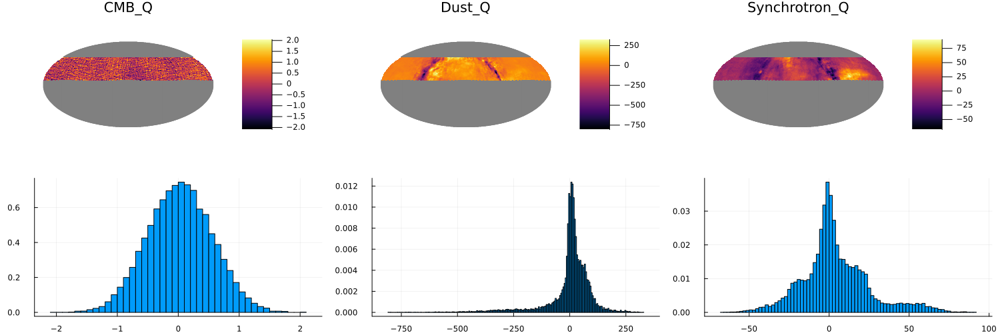

In [14]:
Plots.plot(get_map_and_hist(result_with_error, "Q", nside))

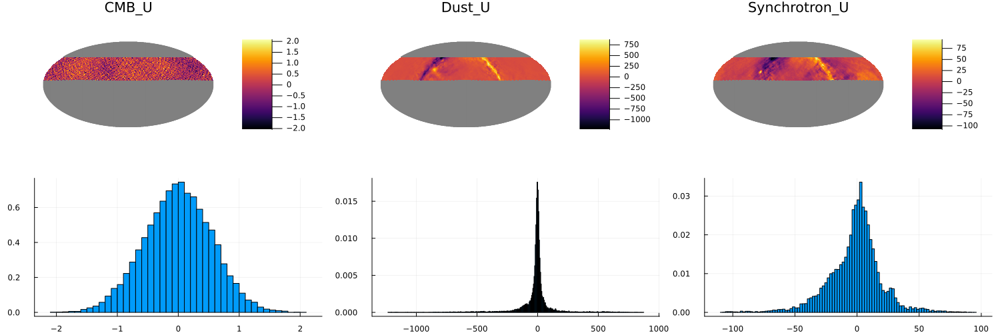

In [15]:
Plots.plot(get_map_and_hist(result_with_error, "U", nside))